In [15]:
import numpy as np
import matplotlib.pyplot as plt
from mast.mast_client import ListType
import pyuda
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
import sys, os

lp_module_path = '/home/cl6305/Documents/data_access/mastu_exhaust_analysis/mastu_exhaust_analysis'
if lp_module_path not in sys.path:
    sys.path.append(lp_module_path)

from mastu_exhaust_analysis.pyLangmuirProbe import LangmuirProbe, compare_shots, probe_array

notebook_functions_path = '/home/cl6305/Documents/data_access/notebooks/plasma_control/diagnostic_analysis/'
if notebook_functions_path not in sys.path:
    sys.path.append(notebook_functions_path)

from custom_diagnostic_functions import *
from fitting_functions import *
import pyuda
client=pyuda.Client()
import matplotlib.pyplot as plt
import numpy as np


"""Plotting settings"""
plt.style.use('default')
plt.rcParams.update({'font.size': 10})
linewidth = 3
markersize = 15


plt.style.use('ggplot')
plt.rcParams["axes.edgecolor"] = "black"
plt.rcParams["axes.linewidth"] = 1
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams.update({'font.size': 14})

shot_number = 49259
# shot_number = 49220
shot_number = 49213
# shot_number = 49259
# shot_number = 49260
# shot_number = 49212

shot_number = 45470


shot_number =  45416

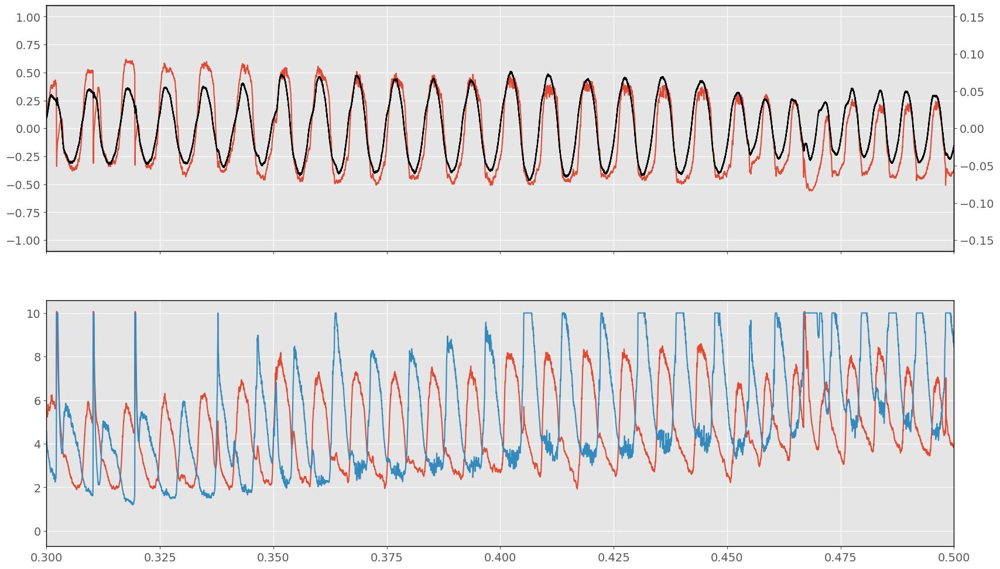

In [14]:
shot_number = 49261

cal_fac = 3.8

d_alpha_sxd, d_alpha_sxd_time = d_alpha_divertor_asymmetry(shot_number, 'SXD', output_time=True, calibrate = cal_fac)
d_alpha_sxd_upper_sig, d_alpha_sxd_lower_sig, d_alpha_sig_time = d_alpha_signal(shot_number, 'SXD', output_time=True, calibrate = cal_fac)



mag_z, mag_time = magnetic_axis_zc(shot_number, output_time=True, trim=True)

fig,ax = plt.subplots(2,1, figsize = (20,12), sharex= True)
axes12 = ax[0].twinx()

ax[0].plot(d_alpha_sxd_time, d_alpha_sxd, label = 'd_alpha_sxd_assymmetry')

axes12.plot(mag_time, mag_z, label = 'mag_z', color = 'black')

ax[0].set_xlim(0.3,0.5)
axes12.grid(False)


ax[1].plot(d_alpha_sig_time, d_alpha_sxd_upper_sig, label = 'd_alpha_sxd_upper_sig')
ax[1].plot(d_alpha_sig_time, d_alpha_sxd_lower_sig, label = 'd_alpha_sxd_lower_sig')

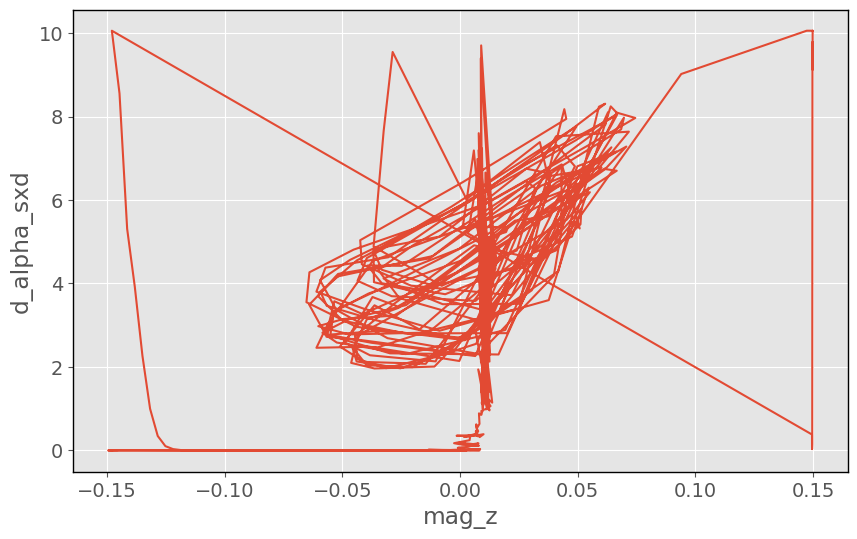

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d


shot_number = 49261

cal_fac = 4

d_alpha_sxd, d_alpha_sxd_time = d_alpha_divertor_asymmetry(shot_number, 'SXD', output_time=True, calibrate = cal_fac)
d_alpha_sxd_upper_sig, d_alpha_sxd_lower_sig, d_alpha_sig_time = d_alpha_signal(shot_number, 'SXD', output_time=True, calibrate = cal_fac)

mag_z, mag_time = magnetic_axis_zc(shot_number, output_time=True, trim=True)

start_time = max(min(mag_time), min(d_alpha_sxd_time))
end_time = min(max(mag_time), max(d_alpha_sxd_time))

common_time = np.linspace(start_time, end_time, num=1000)  

mag_interp = interp1d(mag_time, mag_z, kind='linear', bounds_error=False, fill_value="extrapolate")
d_alpha_sxd_interp = interp1d(d_alpha_sxd_time, d_alpha_sxd_upper_sig, kind='linear', bounds_error=False, fill_value="extrapolate")

mag_z_common = mag_interp(common_time)
d_alpha_sxd_common = d_alpha_sxd_interp(common_time)

plt.figure(figsize=(10, 6))
plt.plot(mag_z_common, d_alpha_sxd_common, label='d_alpha_sxd vs. mag_z')
plt.xlabel('mag_z')
plt.ylabel('d_alpha_sxd')
# plt.ylim(-1.2 ,1.2)
plt.grid(True)
plt.show()


In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt

def low_pass_filter(data, cutoff_frequency, sampling_rate, order=4):
    """
    Apply a low-pass filter to the given data.

    Parameters:
    - data: array-like, the input signal to be filtered
    - cutoff_frequency: float, the cutoff frequency of the filter
    - sampling_rate: float, the sampling rate of the data
    - order: int, optional, the order of the filter (default is 4)

    Returns:
    - filtered_data: array-like, the filtered signal
    """
    nyquist_frequency = 0.5 * sampling_rate
    normal_cutoff = cutoff_frequency / nyquist_frequency
    # Get the filter coefficients
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    # Apply the filter
    filtered_data = filtfilt(b, a, data)
    return filtered_data

def calculate_filtered_asymmetry(shot_number, cutoff_frequency=1000, sampling_rate=100000, order=4, cal_fac=4):
    """
    Calculate the filtered asymmetry for a given shot number.

    Parameters:
    - shot_number: int, the shot number to process
    - cutoff_frequency: float, the cutoff frequency for the low-pass filter
    - sampling_rate: float, the sampling rate of the data
    - order: int, the order of the filter
    - cal_fac: float, calibration factor

    Returns:
    - filtered_asymmetry: array-like, the filtered asymmetry signal
    """
    # Extract signals
    d_alpha_sxd, d_alpha_sxd_time = d_alpha_divertor_asymmetry(shot_number, 'SXD', output_time=True, calibrate=cal_fac)
    d_alpha_sxd_upper_sig, d_alpha_sxd_lower_sig, d_alpha_sig_time = d_alpha_signal(shot_number, 'SXD', output_time=True, calibrate=cal_fac)
    mag_z, mag_time = magnetic_axis_zc(shot_number, output_time=True, trim=True)

    # Filter the signals
    d_alpha_sxd_filtered_upper = low_pass_filter(d_alpha_sxd_upper_sig, cutoff_frequency, sampling_rate, order)
    d_alpha_sxd_filtered_lower = low_pass_filter(d_alpha_sxd_lower_sig, cutoff_frequency, sampling_rate, order)

    # Floor filtered signals to zero
    d_alpha_sxd_filtered_upper[d_alpha_sxd_filtered_upper < 0] = 0
    d_alpha_sxd_filtered_lower[d_alpha_sxd_filtered_lower < 0] = 0

    # Calculate filtered asymmetry
    filtered_asymmetry = (d_alpha_sxd_filtered_upper - d_alpha_sxd_filtered_lower) / \
                         (d_alpha_sxd_filtered_upper + d_alpha_sxd_filtered_lower)

    return filtered_asymmetry

In [ ]:
d_sig = np.array([1,1,1,1,1])
d_time = np.linspace(0, 5, len(d_sig))

mag_sig = np.array([-1,-1,-1,-1,-1,-1,-1,-1,-1])
mag_time = np.linspace(-5,5, len(mag_sig))


In [18]:
import numpy as np

def align_and_interpolate(time_array1, data_set1, time_array2, data_set2, time_range=None):
    """
    Aligns and interpolates two datasets based on their corresponding time arrays,
    with an optional user-specified time range for trimming.

    Parameters:
    - time_array1: np.array, Time points for the first dataset.
    - data_set1: np.array, Data points corresponding to time_array1.
    - time_array2: np.array, Time points for the second dataset.
    - data_set2: np.array, Data points corresponding to time_array2.
    - time_range: tuple, optional, (start_time, end_time) for trimming the data. 
                  Defaults to the common range of the two arrays if not provided.

    Returns:
    - common_time_array: np.array, Aligned and interpolated common time array.
    - interpolated_data1: np.array, Interpolated data points for the first dataset.
    - interpolated_data2: np.array, Interpolated data points for the second dataset.
    """
    # 1. Determine the default common start and end times
    default_start_time = max(time_array1[0], time_array2[0])
    default_end_time = min(time_array1[-1], time_array2[-1])

    # 2. Use the provided time range if specified, otherwise use default
    if time_range is not None:
        start_time = max(default_start_time, time_range[0])
        end_time = min(default_end_time, time_range[1])
    else:
        start_time = default_start_time
        end_time = default_end_time

    # 3. Trim the time arrays and corresponding data sets
    trimmed_time1 = time_array1[(time_array1 >= start_time) & (time_array1 <= end_time)]
    trimmed_data1 = data_set1[(time_array1 >= start_time) & (time_array1 <= end_time)]

    trimmed_time2 = time_array2[(time_array2 >= start_time) & (time_array2 <= end_time)]
    trimmed_data2 = data_set2[(time_array2 >= start_time) & (time_array2 <= end_time)]

    # 4. Create a common time array for interpolation
    desired_length = min(len(trimmed_time1), len(trimmed_time2))
    common_time_array = np.linspace(start_time, end_time, desired_length)

    # 5. Interpolate data sets to the common time array
    interpolated_data1 = np.interp(common_time_array, trimmed_time1, trimmed_data1)
    interpolated_data2 = np.interp(common_time_array, trimmed_time2, trimmed_data2)

    return common_time_array, interpolated_data1, interpolated_data2



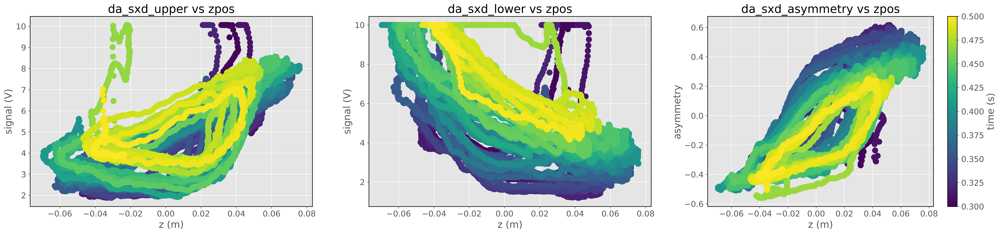

In [19]:
cal_fac = 3.8
d_alpha_sxd, d_alpha_sxd_time = d_alpha_divertor_asymmetry(shot_number, 'SXD', output_time=True, calibrate = cal_fac)
d_alpha_sxd_upper_sig, d_alpha_sxd_lower_sig, d_alpha_sig_time = d_alpha_signal(shot_number, 'SXD', output_time=True, calibrate = cal_fac)

mag_z, mag_time = magnetic_axis_zc(shot_number, output_time=True, trim=True)

time_range = (0.3, 0.5)

c_time, mag_z_interp, d_asym_sig_interp = align_and_interpolate(mag_time,mag_z ,d_alpha_sxd_time,d_alpha_sxd, time_range=time_range)
c_time, mag_z_interp_u, d_upper_sig_interp = align_and_interpolate(mag_time,mag_z ,d_alpha_sxd_time,d_alpha_sxd_upper_sig, time_range=time_range)
c_time, mag_z_interp_l, d_lower_sig_interp = align_and_interpolate(mag_time,mag_z ,d_alpha_sxd_time,d_alpha_sxd_lower_sig, time_range=time_range)

fig,ax = plt.subplots(1,3, figsize = (30,6), dpi = 500)


cax = ax[0].scatter(mag_z_interp_u, d_upper_sig_interp, c = c_time,cmap='viridis', s=100)
ax[0].set_xlabel('z (m)')
ax[0].set_ylabel('signal (V)')
ax[0].set_title('da_sxd_upper vs zpos')



ax[1].scatter(mag_z_interp_l,d_lower_sig_interp,c = c_time,cmap='viridis', s=100)
ax[1].set_xlabel('z (m)')
ax[1].set_ylabel('signal (V)')
ax[1].set_title('da_sxd_lower vs zpos')

ax[2].scatter(mag_z_interp,d_asym_sig_interp,c = c_time,cmap='viridis', s=100)
ax[2].set_xlabel('z (m)')
ax[2].set_ylabel('asymmetry')
ax[2].set_title('da_sxd_asymmetry vs zpos')

# Add a colorbar to the subplot
colorbar = fig.colorbar(cax, ax=ax[2])
colorbar.set_label('time (s)')


In [20]:
fitted_data = exp_function(mag_z_interp_upper, *popt)

# Plot the data and the fit
plt.figure()
plt.scatter(mag_z_interp_upper, d_upper_sig_interp, label='Data points')
plt.plot(mag_z_interp_upper, fitted_data, color='blue', label=f'Fitted curve: {a:.2f}*exp({b:.2f}*x) + {c:.2f}')
plt.xlabel('mag_z')
plt.ylabel('d_sxd_upper')
plt.title('upper_sig_Exponential')
plt.legend()
plt.show()

print(f"Fitted curve equation: y = {a:.2f} * exp({b:.2f} * x) + {c:.2f}")

NameError: name 'mag_z_interp_upper' is not defined

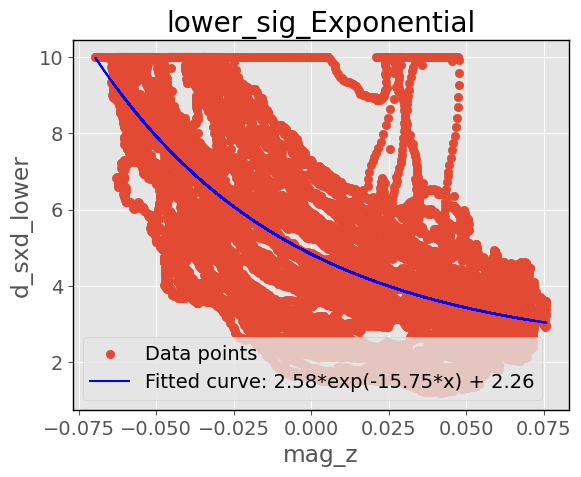

Fitted curve equation: y = 2.58*exp(-15.75*x) + 2.26


In [ ]:
from scipy.optimize import curve_fit

c_time, mag_z_interp_lower, d_lower_sig_interp = align_and_interpolate(mag_time,mag_z ,d_alpha_sxd_time,d_alpha_sxd_lower_sig, time_range=time_range)

def exp_function(x, a, b, c):
    return a * np.exp(b * x) + c

# Fit the model function to the data (e.g., interpolated_data1 and interpolated_data2)
popt, pcov = curve_fit(exp_function, mag_z_interp_lower, d_lower_sig_interp, p0=(1, 0.1, 1))

# Extract optimal parameters
d, e, f = popt

# Generate fitted data using the optimal parameters
fitted_data_lower = exp_function(mag_z_interp_lower, *popt)

# Plot the data and the fit
plt.figure()
plt.scatter(mag_z_interp_lower, d_lower_sig_interp, label='Data points')
plt.plot(mag_z_interp_lower, fitted_data_lower, color='blue', label=f'Fitted curve: {d:.2f}*exp({e:.2f}*x) + {f:.2f}')
plt.xlabel('mag_z')
plt.ylabel('d_sxd_lower')
plt.title('lower_sig_Exponential')
plt.legend()
plt.show()

print(f"Fitted curve equation: y = {d:.2f}*exp({e:.2f}*x) + {f:.2f}")

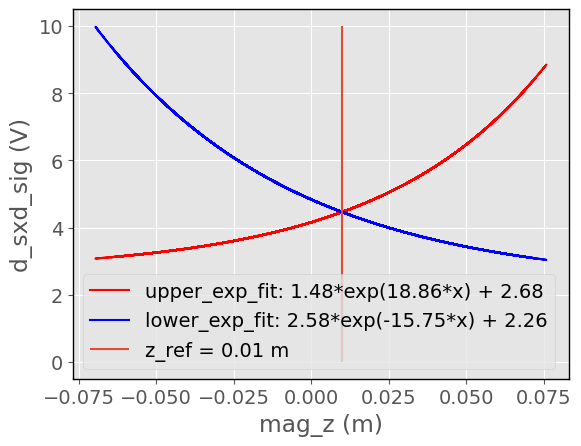

In [ ]:
plt.plot(mag_z_interp_upper, fitted_data_upper, color='red', label=f'upper_exp_fit: {a:.2f}*exp({b:.2f}*x) + {c:.2f}')
plt.plot(mag_z_interp_lower, fitted_data_lower, color='blue', label=f'lower_exp_fit: {d:.2f}*exp({e:.2f}*x) + {f:.2f}')
plt.vlines(0.01, 0,10, label = 'z_ref = 0.01 m')
plt.xlabel('mag_z (m)')
plt.ylabel('d_sxd_sig (V)')
plt.legend()

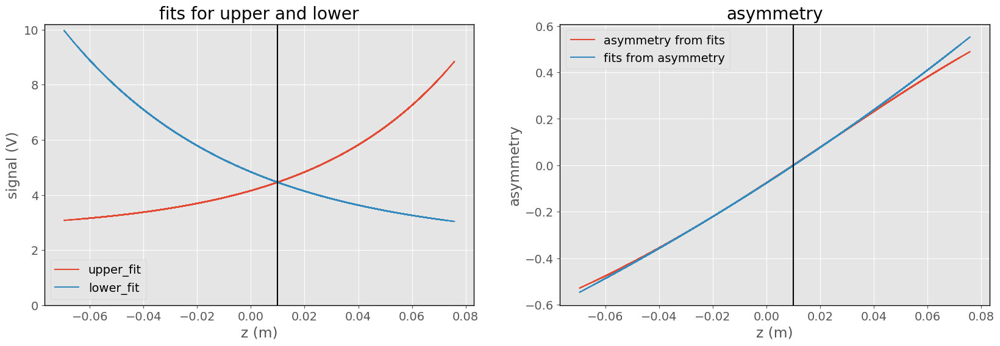

In [21]:
# dzfit = DZFit(mag_z__lower,d_lower_sig_)

cal_fac = 3.8

d_alpha_sxd, d_alpha_sxd_time = d_alpha_divertor_asymmetry(shot_number, 'SXD', output_time=True, calibrate = cal_fac)
d_alpha_sxd_upper_sig, d_alpha_sxd_lower_sig, d_alpha_sig_time = d_alpha_signal(shot_number, 'SXD', output_time=True, calibrate = cal_fac)

mag_z, mag_time = magnetic_axis_zc(shot_number, output_time=True, trim=True)


c_time, mag_z_asym, d_asym = align_and_interpolate(mag_time, mag_z ,d_alpha_sxd_time,d_alpha_sxd, time_range=time_range)
c_time, mag_z_upper, d_upper_sig = align_and_interpolate(mag_time, mag_z ,d_alpha_sig_time,d_alpha_sxd_upper_sig, time_range=time_range)
c_time, mag_z_lower, d_lower_sig= align_and_interpolate(mag_time, mag_z ,d_alpha_sig_time,d_alpha_sxd_lower_sig, time_range=time_range)

upper_fit = DZFit(mag_z_upper,d_upper_sig).fit()
lower_fit = DZFit(mag_z_lower,d_lower_sig).fit()
asym_fit = DZFit(mag_z_asym, d_asym).fit()




asymmetry = (upper_fit - lower_fit)/(upper_fit + lower_fit)

fig,ax = plt.subplots(1,2, figsize = (20,6))
ax[0].plot(mag_z_upper,upper_fit, label = 'upper_fit')
ax[0].plot(mag_z_lower,lower_fit, label = 'lower_fit')

ax[0].axvline(0.01, 0, 10, color = 'black')
ax[0].set_title('fits for upper and lower')
ax[0].set_ylabel('signal (V)')
ax[0].set_xlabel('z (m)')
ax[0].set_ylim(0,10.2)
ax[0].legend()

ax[1].plot(mag_z_asym, asymmetry, label = 'asymmetry from fits')
ax[1].plot(mag_z_asym, asym_fit, label = 'fits from asymmetry')
ax[1].axvline(0.01, color = 'black')
ax[1].set_title('asymmetry')
ax[1].set_ylabel('asymmetry')
ax[1].set_xlabel('z (m)')
ax[1].legend()



# ax[1].plot(mag_z_asym, asym_fit)
# ax[2].axvline(0.01, color = 'black')
# ax[2].set_title('fit_from_asymmetry')
# ax[2].set_xlabel('z (m)')
# ax[2].set_ylabel('asymmetry')
# ax[2].legend()






[ 4.2164533   1.71256224 -4.28974325]


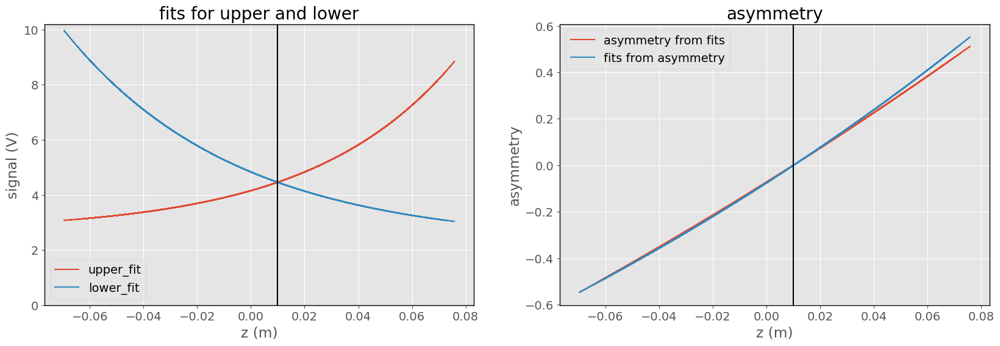

In [32]:
upper_fit,fit_u = DZFit(mag_z_upper,d_upper_sig).fit(output_params=True)

def exp_function(x, a, b, c):
        return a * np.exp(b * x) + c
upper_func = exp_function(mag_z_upper, *fit_u)

lower_fit,fit_l = DZFit(mag_z_lower,d_lower_sig).fit(output_params=True)
lower_func = exp_function(mag_z_lower, *fit_l)

asym_fit,fit_a = DZFit(mag_z_asym, d_asym).fit(output_params=True)
asym_func = exp_function(mag_z_asym, *fit_a)

asymmetry = (upper_func - lower_func)/(upper_func + lower_func)



# asymmetry,as_fit_params = DZFit(mag_z_asym, asymmetry).fit(output_params=True)


print(as_fit_params)

fig,ax = plt.subplots(1,2, figsize = (20,6))
ax[0].plot(mag_z_upper,upper_func, label = 'upper_fit')
ax[0].plot(mag_z_lower,lower_func, label = 'lower_fit')

ax[0].axvline(0.01, 0, 10, color = 'black')
ax[0].set_title('fits for upper and lower')
ax[0].set_ylabel('signal (V)')
ax[0].set_xlabel('z (m)')
ax[0].set_ylim(0,10.2)
ax[0].legend()

ax[1].plot(mag_z_asym, asymmetry, label = 'asymmetry from fits')
ax[1].plot(mag_z_asym, asym_fit, label = 'fits from asymmetry')
ax[1].axvline(0.01, color = 'black')
ax[1].set_title('asymmetry')
ax[1].set_ylabel('asymmetry')
ax[1].set_xlabel('z (m)')
ax[1].legend()



In [ ]:
class DZFit:
    def __init__(self, data_set_x, data_set_y):
        self.data_set_x = data_set_x
        self.data_set_y = data_set_y
        self.params = None
        self.pcov = None
        self.fitted_data = None

    def exp_function(self, x, a, b, c):
        return a * np.exp(b * x) + c

    def fit(self, output_error=False, output_params=False):
        popt, pcov = curve_fit(self.exp_function, self.data_set_x, self.data_set_y, p0=(1, 0.1, 1))
        self.params = popt
        self.pcov = pcov

        # Generate fitted data using the optimal parameters
        self.fitted_data = self.exp_function(self.data_set_x, *popt)

        if output_error:
            # standard deviations
            perr = np.sqrt(np.diag(pcov))
            # Calculate partial derivatives
            dfdx_a = np.exp(popt[1] * self.data_set_x)
            dfdx_b = popt[0] * self.data_set_x * np.exp(popt[1] * self.data_set_x)
            dfdx_c = np.ones_like(self.data_set_x)
            
            # Calculate the confidence interval
            delta = np.sqrt((dfdx_a * perr[0])**2 + (dfdx_b * perr[1])**2 + (dfdx_c * perr[2])**2)
            
            if output_params:
                print(f'Fitted curve equation (params= a, b, c): y = {popt[0]:.2f}*exp({popt[1]:.2f}*x) + {popt[2]:.2f}')
                return self.fitted_data, self.params, delta
            else:
                return self.fitted_data, delta

        if output_params:
            return self.fitted_data, self.params
        else:
            return self.fitted_data

Fitted curve equation (params= a, b, c): y = 4.22*exp(1.71*x) + -4.29


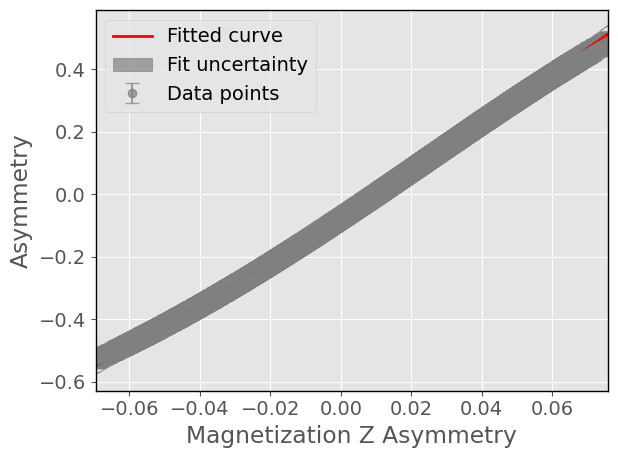

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import numpy as np
import plotly.graph_objects as go


class DZFit:
    def __init__(self, data_set_x, data_set_y):
        self.data_set_x = data_set_x
        self.data_set_y = data_set_y
        self.params = None
        self.pcov = None
        self.fitted_data = None

    def exp_function(self, x, a, b, c):
        return a * np.exp(b * x) + c

    def fit(self, output_error=False, output_params=False):
        popt, pcov = curve_fit(self.exp_function, self.data_set_x, self.data_set_y, p0=(1, 0.1, 1))
        self.params = popt
        self.pcov = pcov

        # Generate fitted data using the optimal parameters
        self.fitted_data = self.exp_function(self.data_set_x, *popt)

        if output_error:
            # Standard deviations of the parameters
            perr = np.sqrt(np.diag(pcov))
            # Calculate partial derivatives (sensitivities) for error propagation
            dfdx_a = np.exp(popt[1] * self.data_set_x)
            dfdx_b = popt[0] * self.data_set_x * np.exp(popt[1] * self.data_set_x)
            dfdx_c = np.ones_like(self.data_set_x)
            
            # Calculate the uncertainty (error propagation)
            delta = np.sqrt((dfdx_a * perr[0])**2 + (dfdx_b * perr[1])**2 + (dfdx_c * perr[2])**2)
            
            if output_params:
                print(f'Fitted curve equation (params= a, b, c): y = {popt[0]:.2f}*exp({popt[1]:.2f}*x) + {popt[2]:.2f}')
                return self.fitted_data, self.params, delta
            else:
                return self.fitted_data, delta

        if output_params:
            return self.fitted_data, self.params
        else:
            return self.fitted_data

# Assuming align_and_interpolate function and data are defined elsewhere
c_time, mag_z_asym, d_asym = align_and_interpolate(mag_time, mag_z, d_alpha_sxd_time, d_alpha_sxd, time_range=time_range)
c_time, mag_z_upper, d_upper_sig = align_and_interpolate(mag_time, mag_z, d_alpha_sig_time, d_alpha_sxd_upper_sig, time_range=time_range)
c_time, mag_z_lower, d_lower_sig = align_and_interpolate(mag_time, mag_z, d_alpha_sig_time, d_alpha_sxd_lower_sig, time_range=time_range)

upper_fit = DZFit(mag_z_upper, d_upper_sig).fit()
lower_fit = DZFit(mag_z_lower, d_lower_sig).fit()
asym_fit = DZFit(mag_z_asym, d_asym).fit()

asymmetry = (upper_fit - lower_fit) / (upper_fit + lower_fit)

dz = DZFit(mag_z_asym, asymmetry)

fit_dat, fit_par, fit_err = dz.fit(output_error=True, output_params=True)

# Plot the original data points with error bars
plt.errorbar(mag_z_asym, asymmetry, yerr=fit_err, fmt='o', label='Data points', color='grey', capsize=5, alpha=0.7)

# Plot the fitted curve
plt.plot(mag_z_asym, fit_dat, label='Fitted curve', color='red', linewidth=2)

# Plot the fit uncertainty as a shaded area or additional line
plt.fill_between(mag_z_asym, fit_dat - fit_err, fit_dat + fit_err, color='black', alpha=0.3, label='Fit uncertainty')

# Adjusting the plot for better readability
plt.xlabel('Magnetization Z Asymmetry')
plt.ylabel('Asymmetry')
plt.xlim(mag_z_asym.min(), mag_z_asym.max())  # Adjust x-axis range if needed
plt.ylim(asymmetry.min() - 0.1, asymmetry.max() + 0.1)  # Adjust y-axis range if needed

plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
fig = go.Figure()

# Add original data points with error bars
fig.add_trace(go.Scatter(
    x=mag_z_asym,
    y=asymmetry,
    mode='markers',
    name='Data points',
    error_y=dict(
        type='data',
        array=fit_err,
        visible=True,
        color='gray',
        thickness=1.5,
        width=3
    ),
    marker=dict(color='gray', size=5, opacity=0.7)
))

# Add fitted curve
fig.add_trace(go.Scatter(
    x=mag_z_asym,
    y=fit_dat,
    mode='lines',
    name='Fitted curve',
    line=dict(color='red', width=2)
))

# Add fit uncertainty as a shaded area
fig.add_trace(go.Scatter(
    x=np.concatenate([mag_z_asym, mag_z_asym[::-1]]),
    y=np.concatenate([fit_dat - fit_err, (fit_dat + fit_err)[::-1]]),
    fill='toself',
    fillcolor='rgba(0,0,0,0.2)',
    line=dict(color='rgba(255,255,255,0)'),
    hoverinfo="skip",
    showlegend=True,
    name='Fit uncertainty'
))

# Customize layout
fig.update_layout(
    xaxis_title='mag z asymmetry',
    yaxis_title='Asymmetry',
    legend=dict(x=0, y=1),
    template='plotly_white'
)

# Display the figure
fig.show()

In [ ]:
# Define a function to down-sample data
def downsample_data(x, y, error, factor=10):
    return x[::factor], y[::factor], error[::factor]

# Down-sample the data
factor = 30  # Adjust this factor as needed
downsampled_x, downsampled_y, downsampled_err = downsample_data(mag_z_asym, asymmetry, fit_err, factor)

# Create the Plotly figure
fig = go.Figure()

# Add down-sampled data points with error bars
fig.add_trace(go.Scatter(
    x=downsampled_x,
    y=downsampled_y,
    mode='markers',
    name='Data points',
    error_y=dict(
        type='data',
        array=downsampled_err,
        visible=True,
        color='gray',
        thickness=1.5,
        width=3
    ),
    marker=dict(color='gray', size=5, opacity=0.7)
))

# Add fitted curve
fig.add_trace(go.Scatter(
    x=mag_z_asym,
    y=fit_dat,
    mode='lines',
    name='Fitted curve',
    line=dict(color='red', width=2)
))

# Add fit uncertainty as a shaded area
fig.add_trace(go.Scatter(
    x=np.concatenate([mag_z_asym, mag_z_asym[::-1]]),
    y=np.concatenate([fit_dat - fit_err, (fit_dat + fit_err)[::-1]]),
    fill='toself',
    fillcolor='rgba(0,0,0,0.2)',
    line=dict(color='rgba(255,255,255,0)'),
    hoverinfo="skip",
    showlegend=True,
    name='Fit uncertainty'
))

# Customize layout
fig.update_layout(
    xaxis_title='Mag z asymmetry',
    yaxis_title='Asymmetry',
    legend=dict(x=0, y=1),
    template='plotly_white'
)

# Display the figure
fig.show()

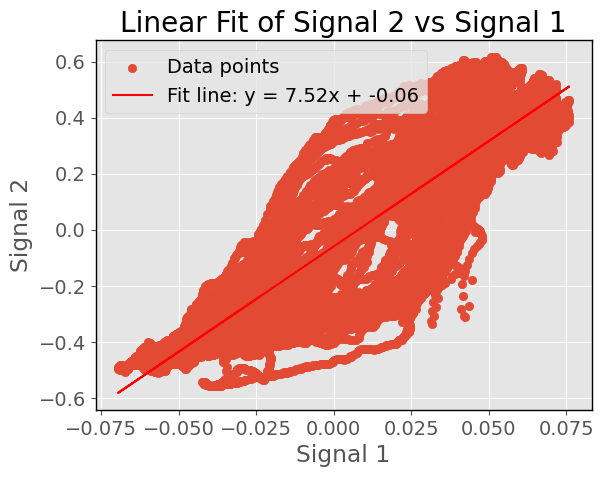

Fitted line equation: y = 7.52x + -0.06


In [ ]:
from scipy.optimize import curve_fit

# Define the linear model function
def linear_model(x, m, b):
    return m * x + b

# Perform the linear fit using curve_fit
popt, _ = curve_fit(linear_model, mag_z_interp, d_asym_sig_interp)
m, b = popt

# Generate fitted data
fitted_data = linear_model(mag_z_interp, m, b)

# Plot data and the fit line
plt.figure()
plt.scatter(mag_z_interp, d_asym_sig_interp, label='Data points')
plt.plot(mag_z_interp, fitted_data, color='red', label=f'Fit line: y = {m:.2f}x + {b:.2f}')
plt.xlabel('Signal 1')
plt.ylabel('Signal 2')
plt.title('Linear Fit of Signal 2 vs Signal 1')
plt.legend()
plt.show()

print(f"Fitted line equation: y = {m:.2f}x + {b:.2f}")


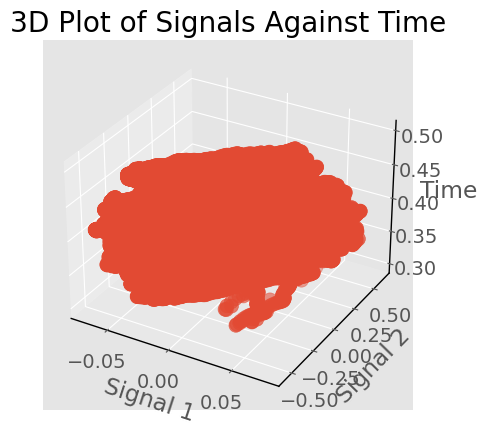

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Example data (replace these with the results from align_and_interpolate)
common_time_array = c_time
interpolated_data1 = mag_z_interp
interpolated_data2 = d_asym_sig_interp

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# 3D Scatter plot
ax.scatter(interpolated_data1, interpolated_data2, common_time_array, s=100)

# Add labels and title
ax.set_xlabel('Signal 1')
ax.set_ylabel('Signal 2')
ax.set_zlabel('Time')
ax.set_title('3D Plot of Signals Against Time')

plt.show()

In [ ]:
import plotly.graph_objects as go
import numpy as np

# Create a 3D scatter plot using Plotly
fig = go.Figure(data=[go.Scatter3d(
    x=interpolated_data1,
    y=interpolated_data2,
    z=common_time_array,
    mode='markers',
    marker=dict(
        size=5,
        color=common_time_array,  # Use time for color
        colorscale='Viridis',
        opacity=0.8
    )
)])

# Update layout for titles and labels
fig.update_layout(
    title='3D Plot of Signals Against Time',
    scene=dict(
        xaxis_title='mag_z',
        yaxis_title='d_alpha_assymmetry',
        zaxis_title='Time'
    )
)

fig.show()


In [ ]:
# ax[1].scatter(mag_z_interp_l,d_lower_sig_interp,c = c_time,cmap='viridis', s=100)

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Example data (replace these with the results from align_and_interpolate)
common_time_array = c_time
interpolated_data1 = mag_z_interp
interpolated_data2 = d_lower_sig_interp

# Create a 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# 3D Scatter plot
ax.scatter(interpolated_data1, interpolated_data2, common_time_array, s=100)

# Add labels and title
ax.set_xlabel('Signal 1')
ax.set_ylabel('Signal 2')
ax.set_zlabel('Time')
ax.set_title('3D Plot of Signals Against Time')

plt.show()

In [ ]:
import plotly.graph_objects as go
import numpy as np

# Create a 3D scatter plot using Plotly
fig = go.Figure(data=[go.Scatter3d(
    x=interpolated_data1,
    y=interpolated_data2,
    z=common_time_array,
    mode='markers',
    marker=dict(
        size=5,
        color=common_time_array,  # Use time for color
        colorscale='Viridis',
        opacity=0.8
    )
)])

# Update layout for titles and labels
fig.update_layout(
    title='3D Plot of Signals Against Time',
    scene=dict(
        xaxis_title='mag_z',
        yaxis_title='d_alpha_assymmetry',
        zaxis_title='Time'
    )
)

fig.show()
